In [44]:
%load_ext autoreload
%autoreload 2
import unet
import torch
import torch.nn as nn

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [120]:
model = unet.UNet(skip_connections=True, padding=0)

img = torch.randn(2, 1, 270, 270)
out = model(img)
out.size()

torch.Size([2, 64, 266, 266])
torch.Size([2, 128, 129, 129])
torch.Size([2, 256, 60, 60])
torch.Size([2, 512, 26, 26])
torch.Size([2, 1024, 9, 9])
torch.Size([2, 512, 14, 14])
torch.Size([2, 256, 24, 24])
torch.Size([2, 128, 44, 44])


torch.Size([2, 1, 84, 84])

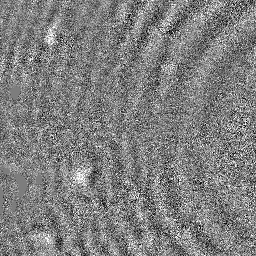

In [197]:
from PIL import Image
img_path = 'data/image_0002.png'
img = Image.open(img_path)
img.crop((256,0,512,256))

In [166]:
def plot_reconstruction(output, target):
    fig, (ax1, ax2) = plt.subplots(1,2)
    ax1.axis('off')
    ax2.axis('off')
    ax1.imshow(target.detach().cpu().numpy()[0][0], cmap='gray')
    ax2.imshow(output.detach().cpu().numpy()[0][0], cmap='gray')
    plt.show()    

In [167]:
import numpy as np
device = ("cuda" if torch.cuda.is_available() else "cpu")
tensor_img = torch.Tensor(np.array(img.crop((256,0,512,256))) / (2**16)).unsqueeze(0).unsqueeze(0)
tensor_img = tensor_img.to(device)
model = unet.UNet(skip_connections=False, padding=1)
model.to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

num_batches = 1000

Step: 0	Loss: 0.11676855385303497


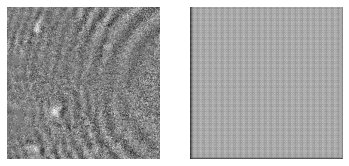

Step: 10	Loss: 0.2123367190361023


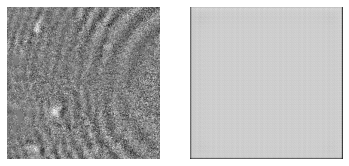

Step: 20	Loss: 1.0146119594573975


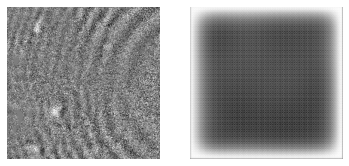

Step: 30	Loss: 0.040988001972436905


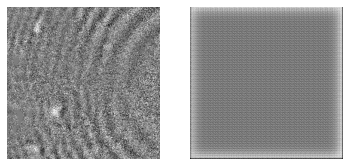

Step: 40	Loss: 0.03234294801950455


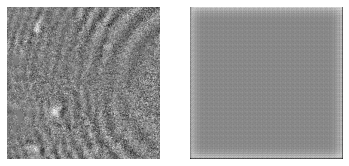

Step: 50	Loss: 0.029927384108304977


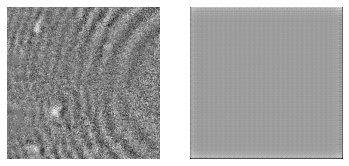

Step: 60	Loss: 0.029186341911554337


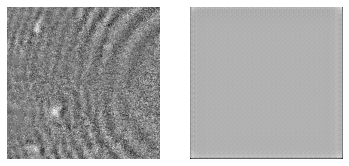

Step: 70	Loss: 0.02882539853453636


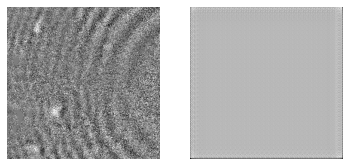

Step: 80	Loss: 0.028546687215566635


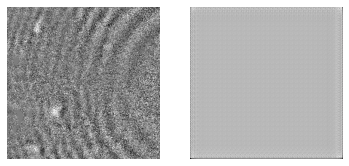

Step: 90	Loss: 0.028374725952744484


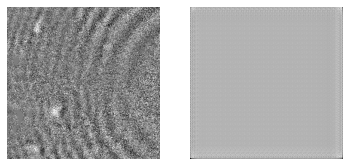

Step: 100	Loss: 0.028324536979198456


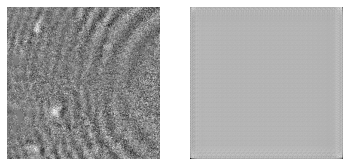

Step: 110	Loss: 0.028219524770975113


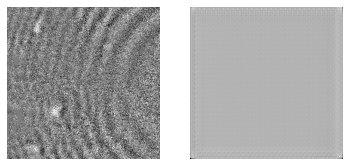

Step: 120	Loss: 0.02819061279296875


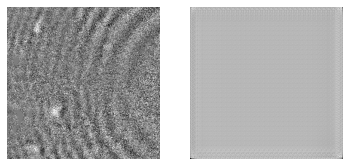

Step: 130	Loss: 0.02814861759543419


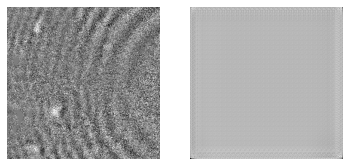

Step: 140	Loss: 0.02812928333878517


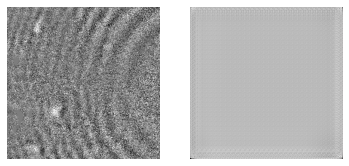

Step: 150	Loss: 0.028127379715442657


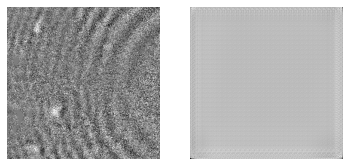

Step: 160	Loss: 0.028140578418970108


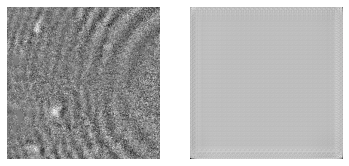

Step: 170	Loss: 0.028072699904441833


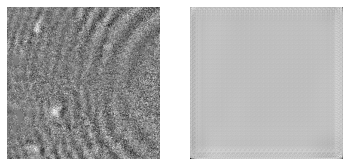

Step: 180	Loss: 0.028014153242111206


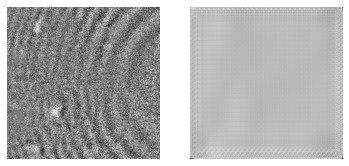

Step: 190	Loss: 0.027978450059890747


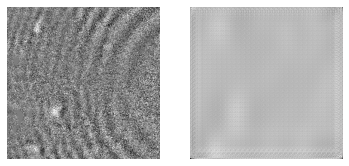

Step: 200	Loss: 0.027918830513954163


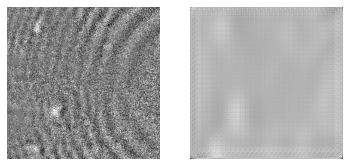

Step: 210	Loss: 0.02786324732005596


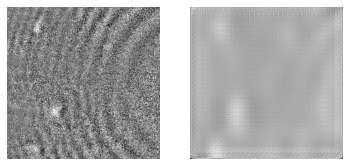

Step: 220	Loss: 0.02769496664404869


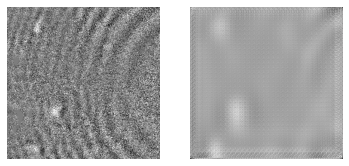

Step: 230	Loss: 0.027610834687948227


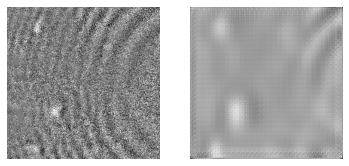

Step: 240	Loss: 0.027325108647346497


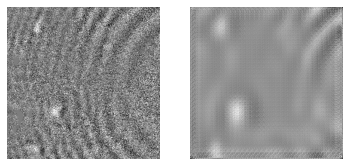

Step: 250	Loss: 0.02817654237151146


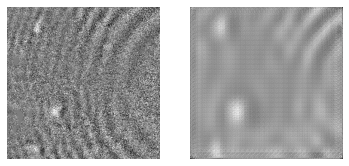

Step: 260	Loss: 0.027134736999869347


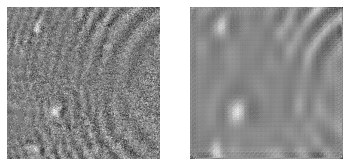

Step: 270	Loss: 0.026855261996388435


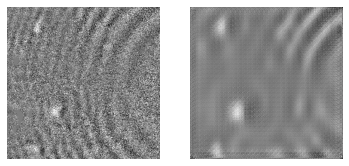

Step: 280	Loss: 0.0265682153403759


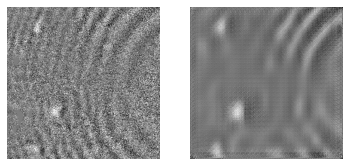

Step: 290	Loss: 0.02651170827448368


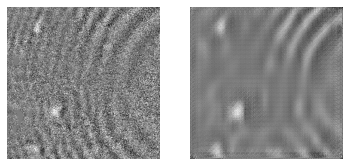

Step: 300	Loss: 0.026226643472909927


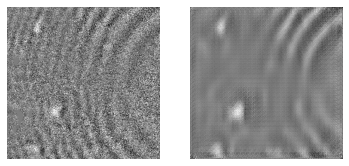

Step: 310	Loss: 0.02600875496864319


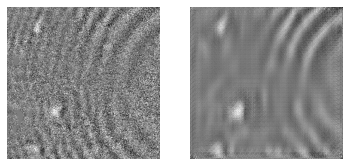

Step: 320	Loss: 0.025732846930623055


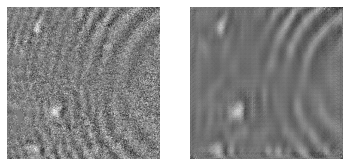

Step: 330	Loss: 0.02583080157637596


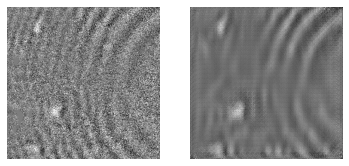

Step: 340	Loss: 0.02536258101463318


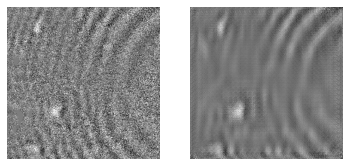

Step: 350	Loss: 0.02502465434372425


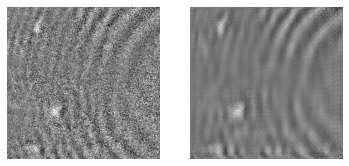

Step: 360	Loss: 0.02480166032910347


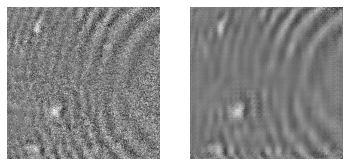

Step: 370	Loss: 0.024939756840467453


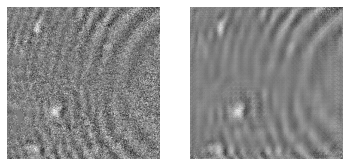

Step: 380	Loss: 0.024440020322799683


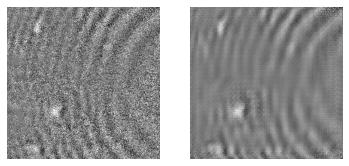

Step: 390	Loss: 0.024258453398942947


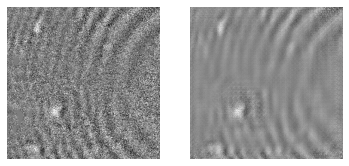

Step: 400	Loss: 0.02392495609819889


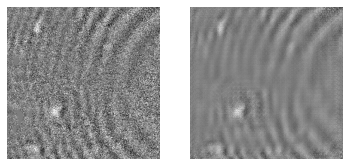

Step: 410	Loss: 0.023680053651332855


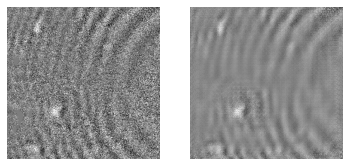

Step: 420	Loss: 0.023974645882844925


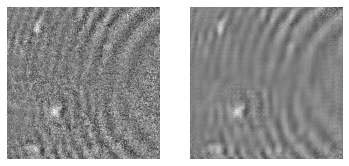

Step: 430	Loss: 0.023426566272974014


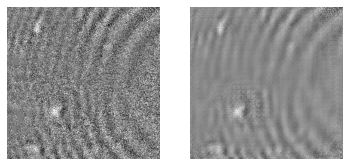

Step: 440	Loss: 0.02311668172478676


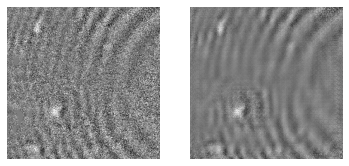

Step: 450	Loss: 0.02296844683587551


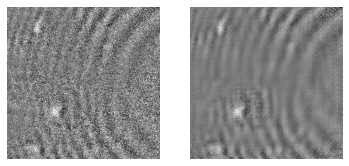

Step: 460	Loss: 0.02261914499104023


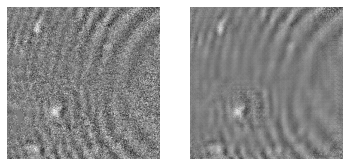

Step: 470	Loss: 0.02268359251320362


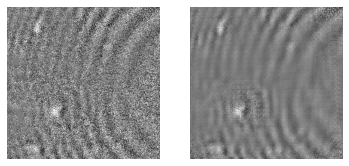

Step: 480	Loss: 0.022134723141789436


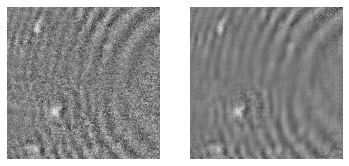

Step: 490	Loss: 0.022041160613298416


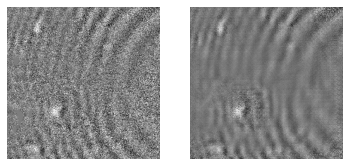

Step: 500	Loss: 0.0216192789375782


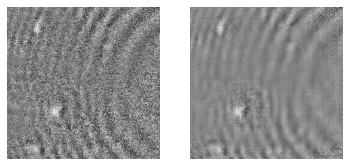

Step: 510	Loss: 0.02183414436876774


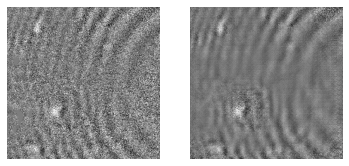

Step: 520	Loss: 0.02352239191532135


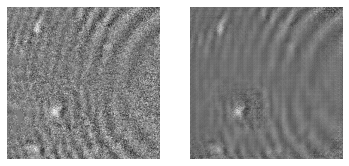

Step: 530	Loss: 0.02231268584728241


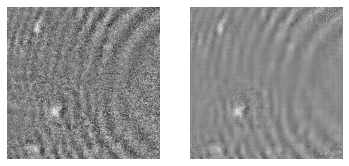

Step: 540	Loss: 0.02108672820031643


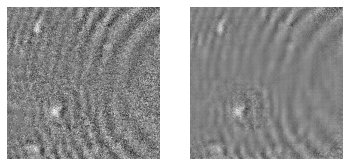

Step: 550	Loss: 0.02024644985795021


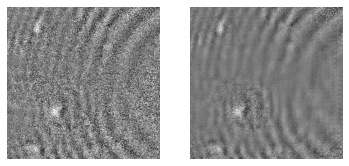

Step: 560	Loss: 0.01981174945831299


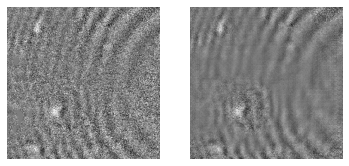

Step: 570	Loss: 0.01952926628291607


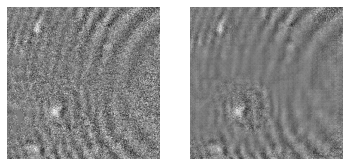

Step: 580	Loss: 0.01858706772327423


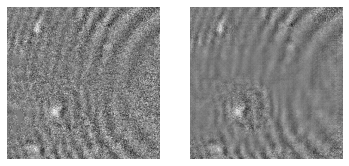

Step: 590	Loss: 0.018847018480300903


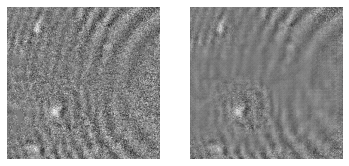

Step: 600	Loss: 0.019142664968967438


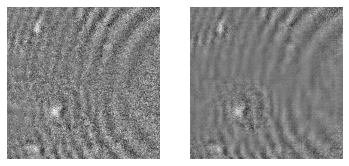

Step: 610	Loss: 0.017872165888547897


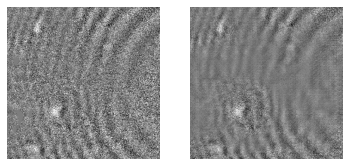

Step: 620	Loss: 0.01693887636065483


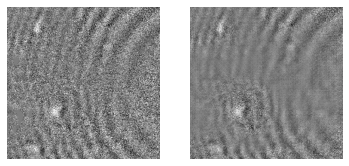

Step: 630	Loss: 0.01722205989062786


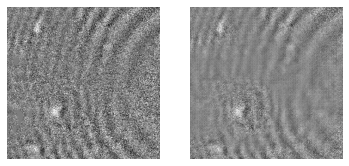

Step: 640	Loss: 0.01713215373456478


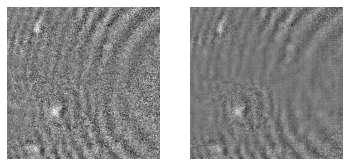

Step: 650	Loss: 0.016750939190387726


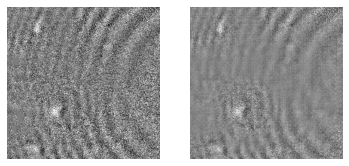

Step: 660	Loss: 0.01586669683456421


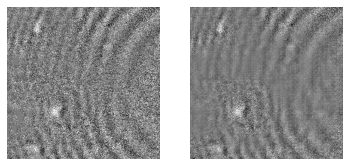

Step: 670	Loss: 0.014547443017363548


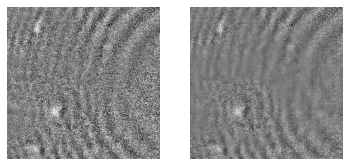

Step: 680	Loss: 0.014008168131113052


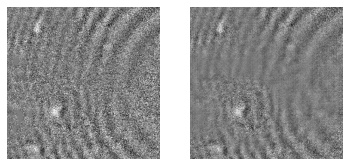

Step: 690	Loss: 0.014477054588496685


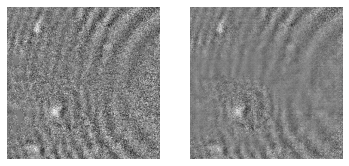

Step: 700	Loss: 0.013949943706393242


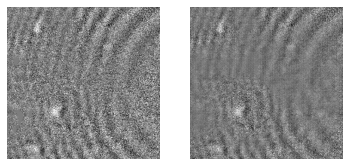

Step: 710	Loss: 0.012478141114115715


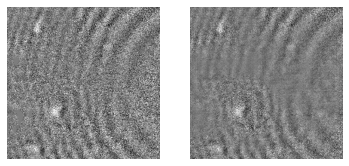

Step: 720	Loss: 0.01264175958931446


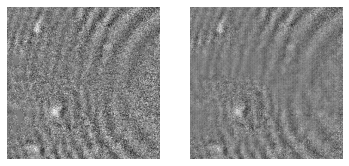

Step: 730	Loss: 0.012604115530848503


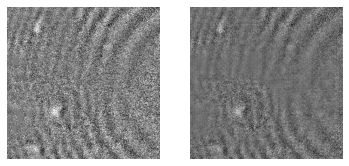

Step: 740	Loss: 0.014169493690133095


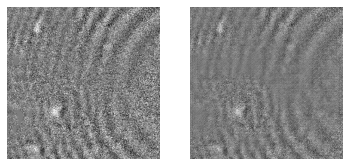

Step: 750	Loss: 0.011556848883628845


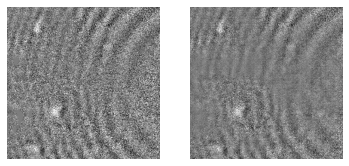

Step: 760	Loss: 0.01073012501001358


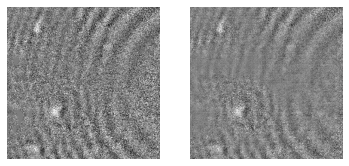

Step: 770	Loss: 0.01085958443582058


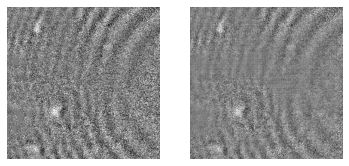

Step: 780	Loss: 0.012364491820335388


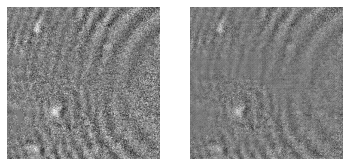

Step: 790	Loss: 0.010238561779260635


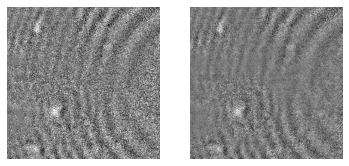

Step: 800	Loss: 0.00888366810977459


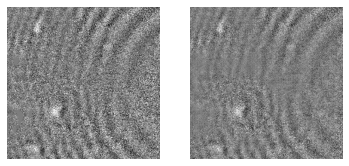

Step: 810	Loss: 0.008524635806679726


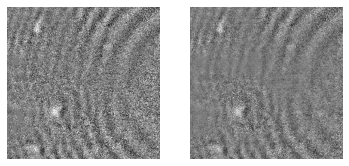

Step: 820	Loss: 0.009129553101956844


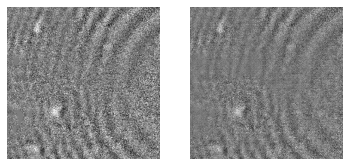

Step: 830	Loss: 0.00894665066152811


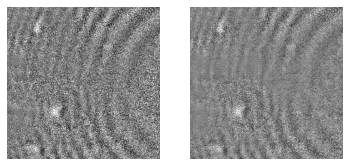

Step: 840	Loss: 0.008570445701479912


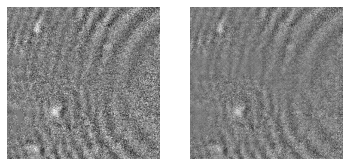

Step: 850	Loss: 0.0072158644907176495


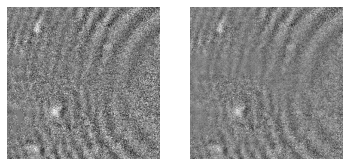

Step: 860	Loss: 0.006893770303577185


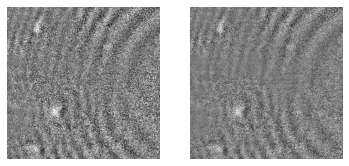

Step: 870	Loss: 0.0070847924798727036


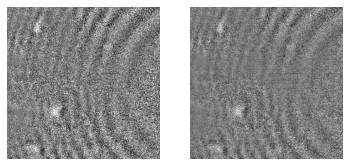

Step: 880	Loss: 0.005742534063756466


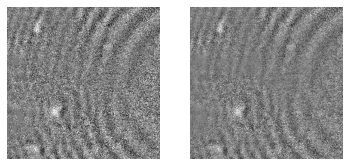

Step: 890	Loss: 0.00769694522023201


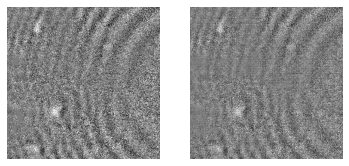

Step: 900	Loss: 0.0071877953596413136


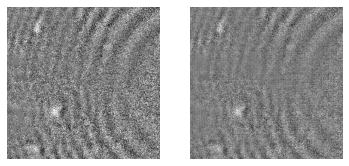

Step: 910	Loss: 0.0054216040298342705


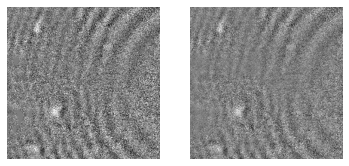

Step: 920	Loss: 0.004778701812028885


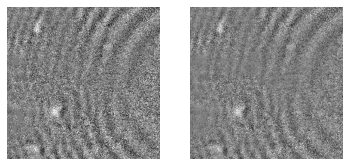

Step: 930	Loss: 0.004260317888110876


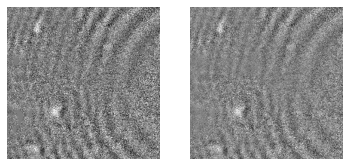

Step: 940	Loss: 0.00455179437994957


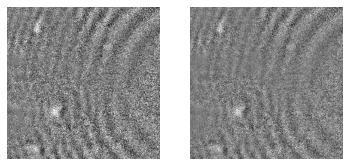

Step: 950	Loss: 0.0040956647135317326


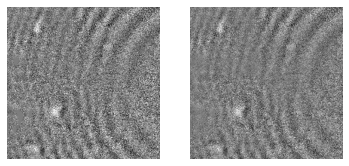

Step: 960	Loss: 0.0037332596257328987


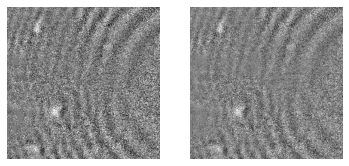

Step: 970	Loss: 0.003740691812708974


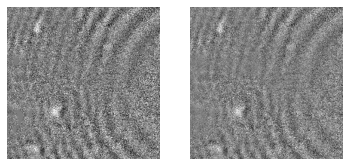

Step: 980	Loss: 0.0049232556484639645


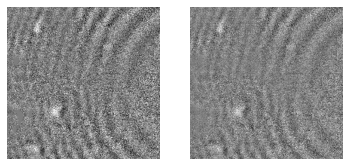

Step: 990	Loss: 0.0036986598279327154


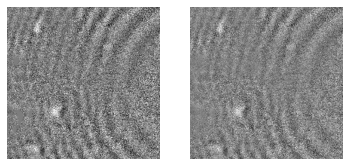

In [168]:
losses = []
for i in range(num_batches):
    optimizer.zero_grad()
    model.train()
    output = model(tensor_img)
    loss = criterion(tensor_img, output)
    loss.backward()
    losses += [loss.item()]
    optimizer.step()
    if i % 10 == 0:
        print(f"Step: {i}\tLoss: {losses[-1]}")
        plot_reconstruction(output, tensor_img)

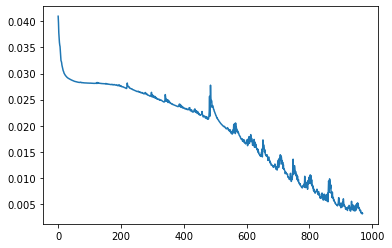

In [169]:
import matplotlib.pyplot as plt

plt.plot(losses[30:])

# Use no padding and image mirroring

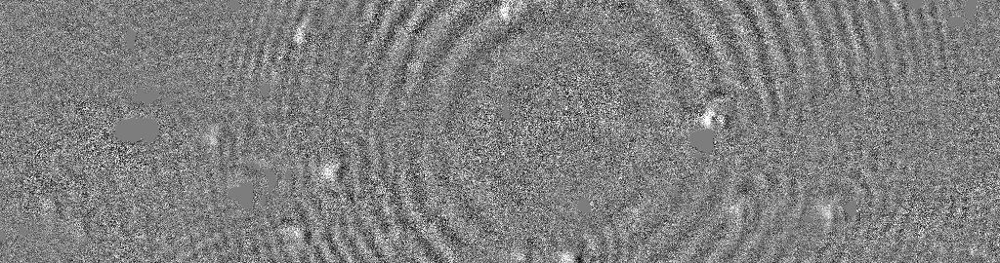

In [130]:
img

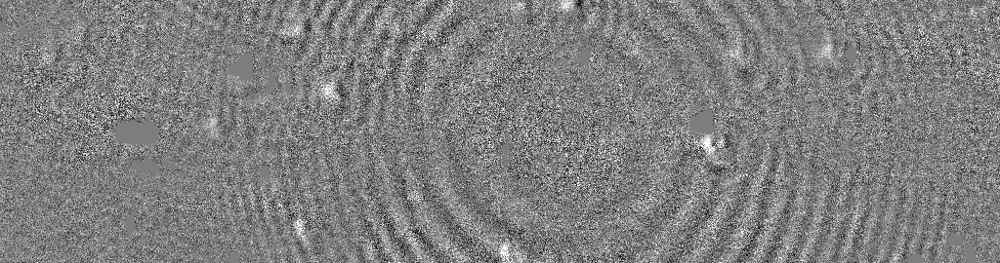

In [133]:
from PIL import ImageOps

flipped

In [145]:
def mirror_image(img):
    flipped = ImageOps.flip(img)
    dst = Image.new('I', (img.width, img.height + flipped.height))
    dst.paste(img, (0,0))
    dst.paste(img, (0,img.height))
    return dst
mirrored = mirror_image(img)

92
92


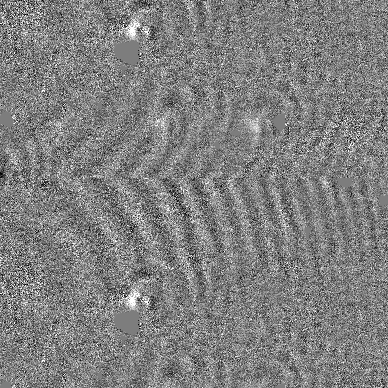

In [174]:
def center_crop(img, new_dims):
    padding_x = (img.size[0] - new_dims[0]) // 2
    padding_y = (img.size[1] - new_dims[1]) // 2
    print(padding_x)
    print(padding_y)
    return img.crop((padding_x, padding_y, padding_x + new_dims[0], padding_y + new_dims[1]))

center_crop(mirrored.crop((500,0,1072,572)), (388, 388))

In [192]:
import numpy as np
device = ("cuda" if torch.cuda.is_available() else "cpu")
img_crop = mirrored.crop((500,0,1012,512))
tensor_img = torch.Tensor(np.array(img_crop) / (2**16)).unsqueeze(0).unsqueeze(0)
tensor_img = tensor_img.to(device)
target = torch.Tensor(np.array(center_crop(img_crop, (388,388))) / (2**16)).unsqueeze(0).unsqueeze(0).to(device)
model = unet.UNet(skip_connections=False, padding=1)
model.to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

num_batches = 1000

62
62


In [189]:
tensor_img.size()

torch.Size([1, 1, 572, 572])

Step: 0	Loss: 0.08727044612169266


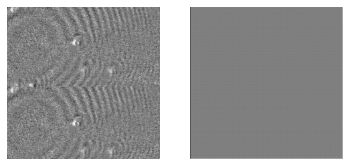

Step: 10	Loss: 0.6660498976707458


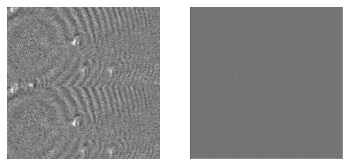

Step: 20	Loss: 0.1596464216709137


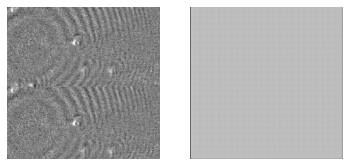

Step: 30	Loss: 0.03406282514333725


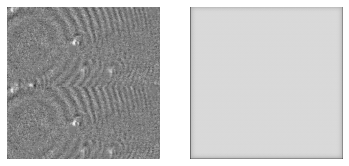

Step: 40	Loss: 0.028474727645516396


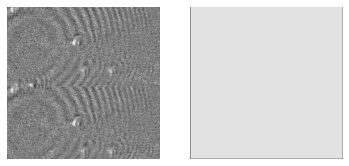

Step: 50	Loss: 0.02735578455030918


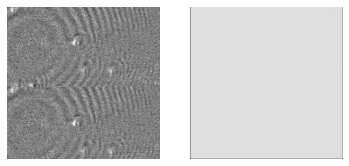

Step: 60	Loss: 0.027101673185825348


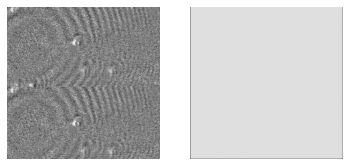

Step: 70	Loss: 0.026942772790789604


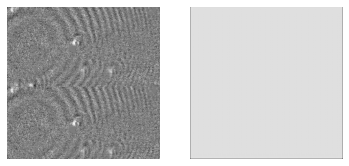

Step: 80	Loss: 0.02683497965335846


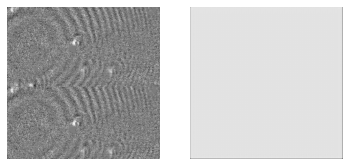

Step: 90	Loss: 0.02678072266280651


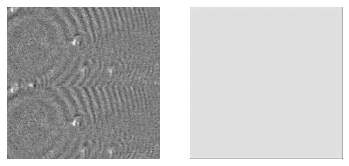

Step: 100	Loss: 0.026748165488243103


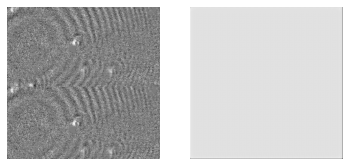

Step: 110	Loss: 0.02671520784497261


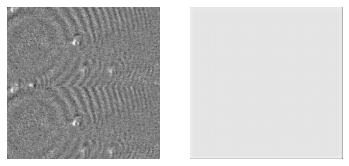

Step: 120	Loss: 0.026679202914237976


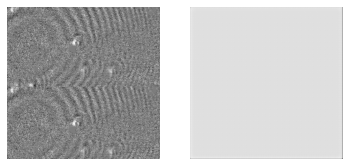

Step: 130	Loss: 0.026643715798854828


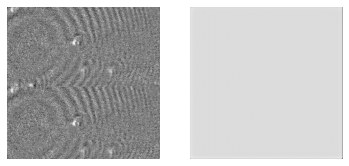

Step: 140	Loss: 0.026618406176567078


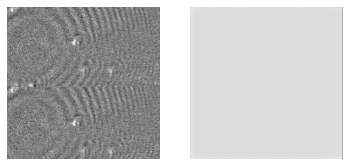

Step: 150	Loss: 0.026603370904922485


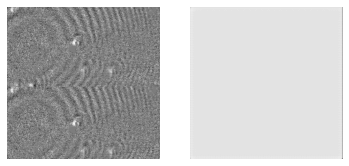

Step: 160	Loss: 0.026591043919324875


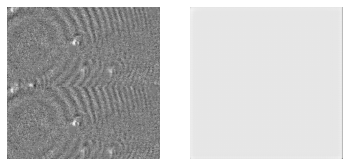

Step: 170	Loss: 0.026575427502393723


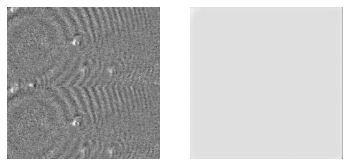

Step: 180	Loss: 0.026548195630311966


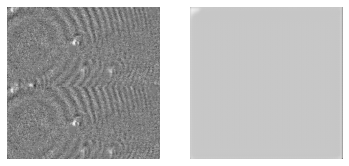

Step: 190	Loss: 0.0265163853764534


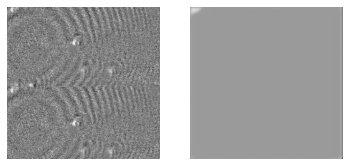

Step: 200	Loss: 0.0264902226626873


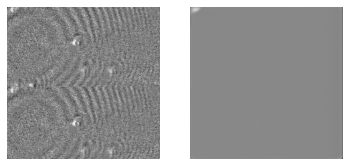

Step: 210	Loss: 0.02645866945385933


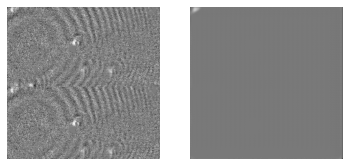

Step: 220	Loss: 0.026428135111927986


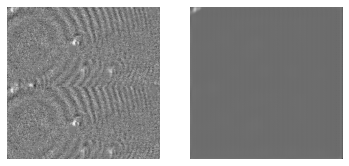

Step: 230	Loss: 0.026454586535692215


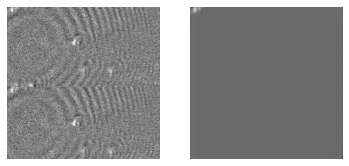

Step: 240	Loss: 0.026412200182676315


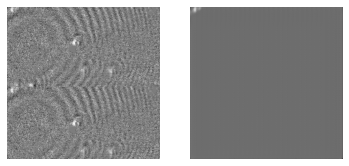

Step: 250	Loss: 0.026415016502141953


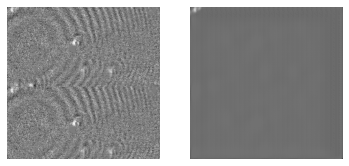

Step: 260	Loss: 0.026413239538669586


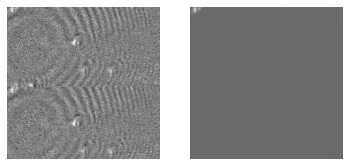

Step: 270	Loss: 0.026378635317087173


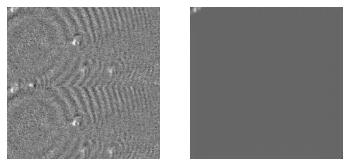

Step: 280	Loss: 0.02635079249739647


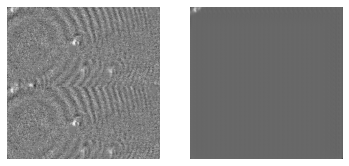

Step: 290	Loss: 0.026326799765229225


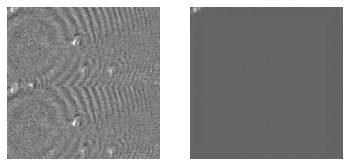

Step: 300	Loss: 0.02630515769124031


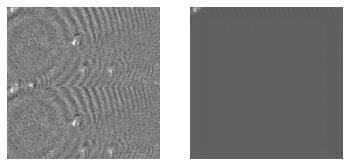

Step: 310	Loss: 0.02630731090903282


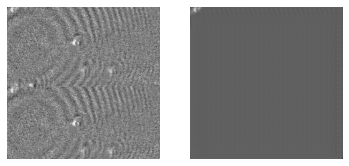

Step: 320	Loss: 0.026266876608133316


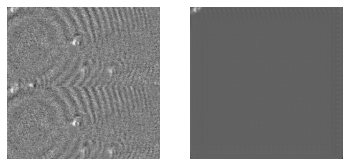

Step: 330	Loss: 0.026222199201583862


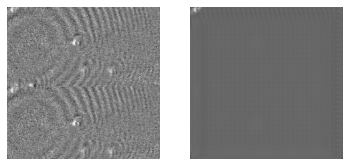

Step: 340	Loss: 0.026231713593006134


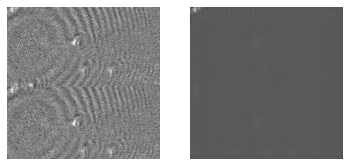

Step: 350	Loss: 0.02607707306742668


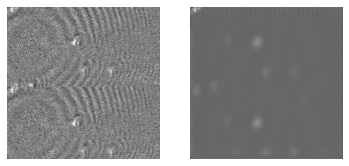

Step: 360	Loss: 0.025960911065340042


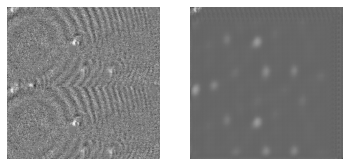

Step: 370	Loss: 0.025897186249494553


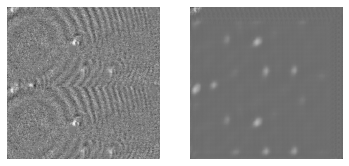

Step: 380	Loss: 0.02589530125260353


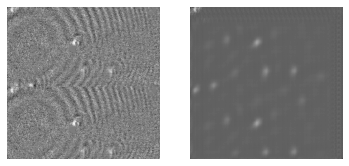

Step: 390	Loss: 0.025726206600666046


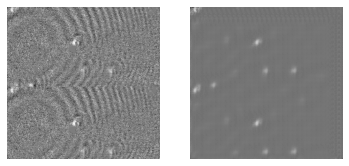

Step: 400	Loss: 0.025606922805309296


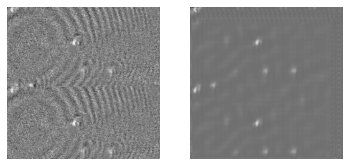

Step: 410	Loss: 0.025503195822238922


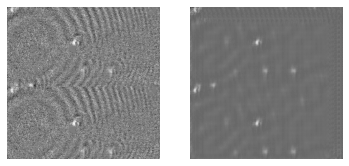

Step: 420	Loss: 0.025444407016038895


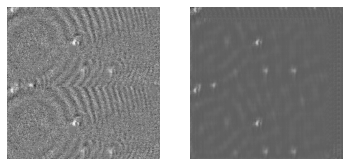

Step: 430	Loss: 0.025281183421611786


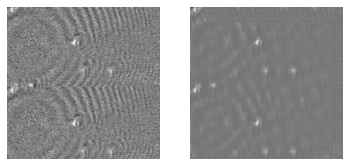

Step: 440	Loss: 0.02504749596118927


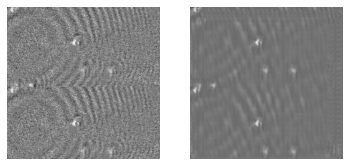

Step: 450	Loss: 0.025063276290893555


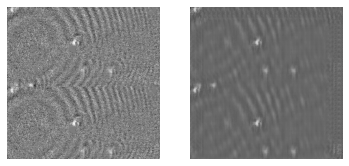

Step: 460	Loss: 0.02478449046611786


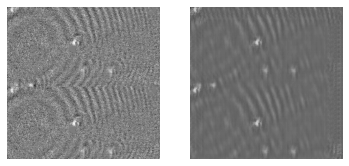

Step: 470	Loss: 0.02450709603726864


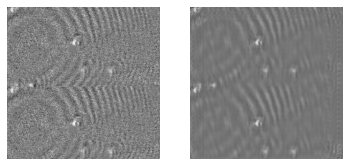

Step: 480	Loss: 0.024281516671180725


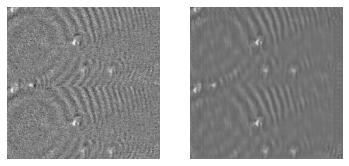

Step: 490	Loss: 0.024020880460739136


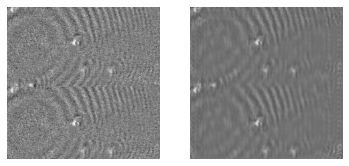

Step: 500	Loss: 0.023914288729429245


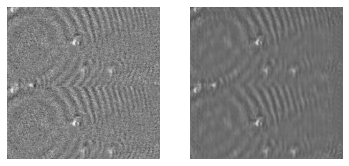

Step: 510	Loss: 0.023833829909563065


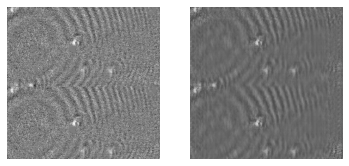

Step: 520	Loss: 0.023539908230304718


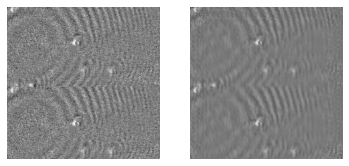

Step: 530	Loss: 0.023186657577753067


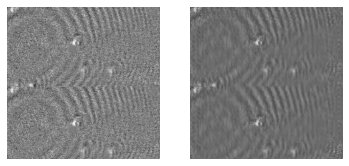

Step: 540	Loss: 0.022887030616402626


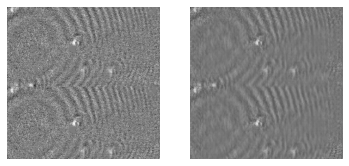

Step: 550	Loss: 0.02284383401274681


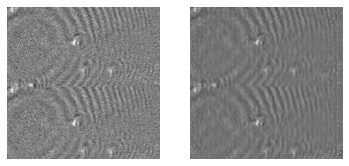

Step: 560	Loss: 0.022434143349528313


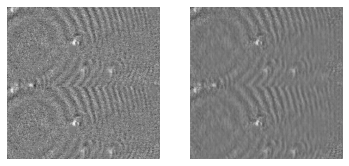

Step: 570	Loss: 0.022556796669960022


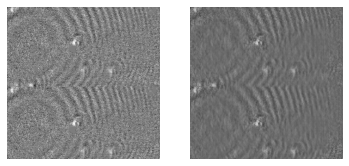

Step: 580	Loss: 0.022308582440018654


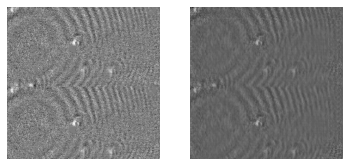

Step: 590	Loss: 0.021647676825523376


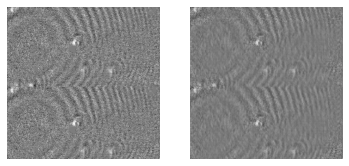

Step: 600	Loss: 0.02149326354265213


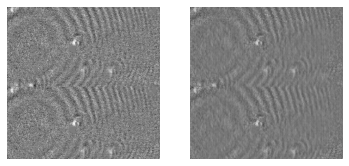

Step: 610	Loss: 0.02137746848165989


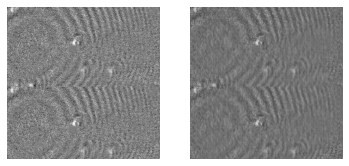

Step: 620	Loss: 0.020832959562540054


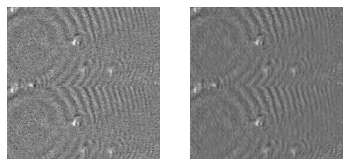

Step: 630	Loss: 0.020669177174568176


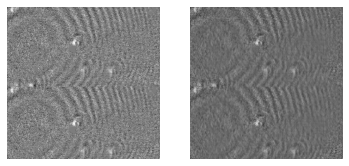

Step: 640	Loss: 0.02045869641005993


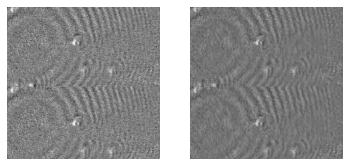

Step: 650	Loss: 0.01993119716644287


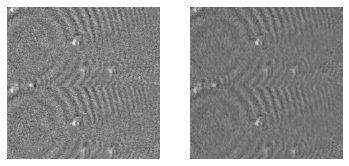

Step: 660	Loss: 0.01992623135447502


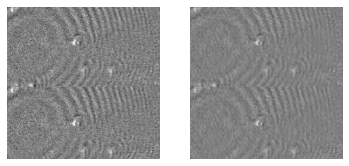

Step: 670	Loss: 0.019092582166194916


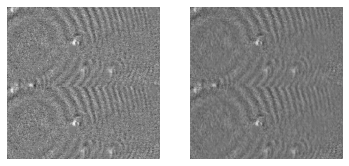

Step: 680	Loss: 0.018777504563331604


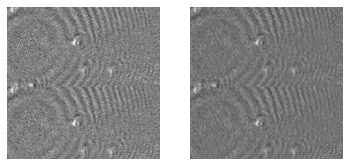

Step: 690	Loss: 0.0184970460832119


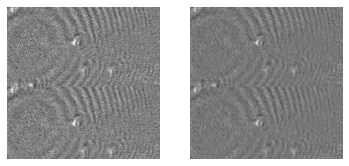

Step: 700	Loss: 0.018198655918240547


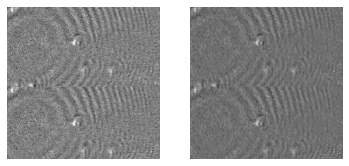

Step: 710	Loss: 0.01801694929599762


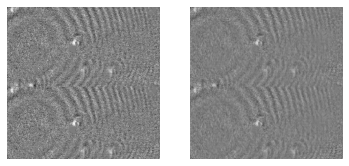

Step: 720	Loss: 0.018196912482380867


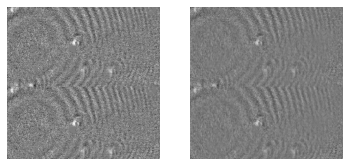

Step: 730	Loss: 0.01756361871957779


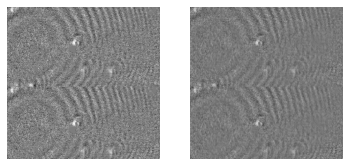

Step: 740	Loss: 0.01674707606434822


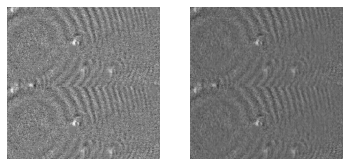

Step: 750	Loss: 0.01663385145366192


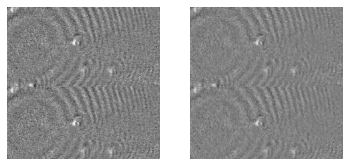

Step: 760	Loss: 0.016482599079608917


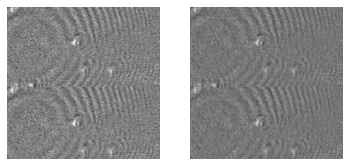

Step: 770	Loss: 0.015765944495797157


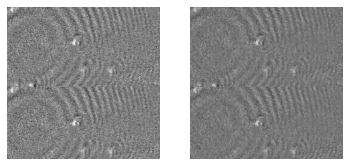

Step: 780	Loss: 0.015343345701694489


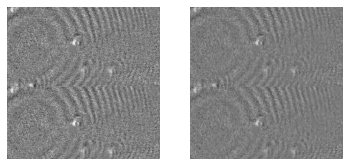

Step: 790	Loss: 0.015067585743963718


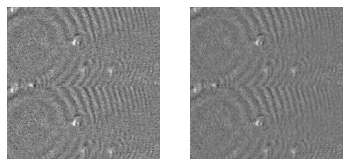

Step: 800	Loss: 0.015661858022212982


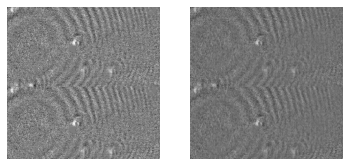

Step: 810	Loss: 0.01433870941400528


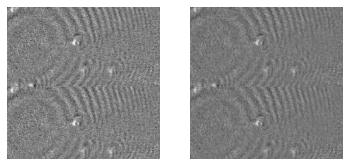

Step: 820	Loss: 0.014567693695425987


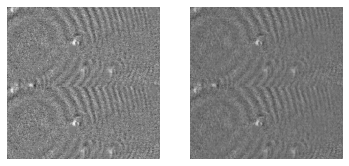

Step: 830	Loss: 0.014011729508638382


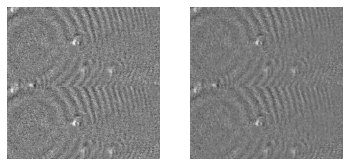

Step: 840	Loss: 0.014208829961717129


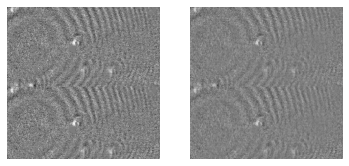

Step: 850	Loss: 0.013090914115309715


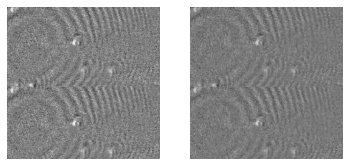

Step: 860	Loss: 0.013727202080190182


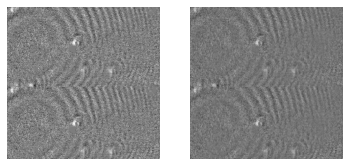

Step: 870	Loss: 0.013707425445318222


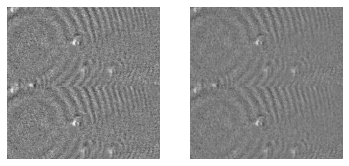

Step: 880	Loss: 0.012465039268136024


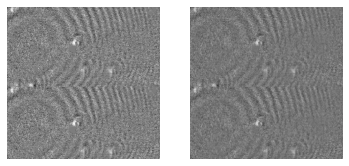

Step: 890	Loss: 0.012031314894557


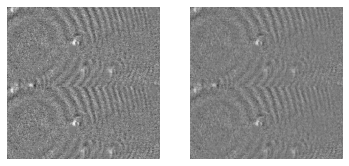

Step: 900	Loss: 0.012181605212390423


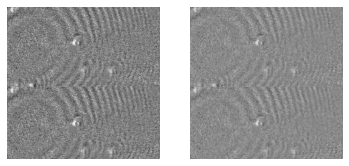

Step: 910	Loss: 0.011257129721343517


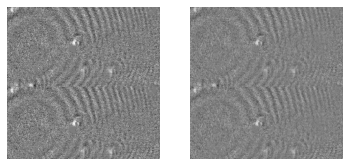

Step: 920	Loss: 0.011456046253442764


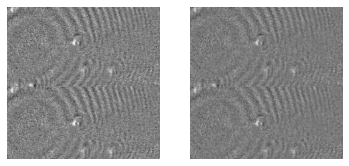

Step: 930	Loss: 0.010863818228244781


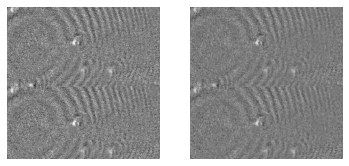

Step: 940	Loss: 0.011347219347953796


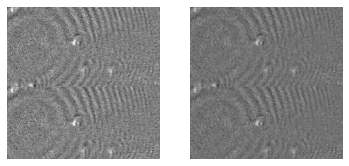

Step: 950	Loss: 0.010395016521215439


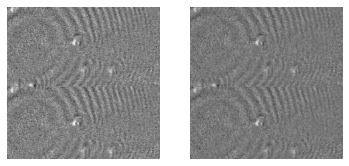

Step: 960	Loss: 0.010341309010982513


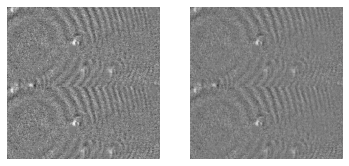

Step: 970	Loss: 0.010324185714125633


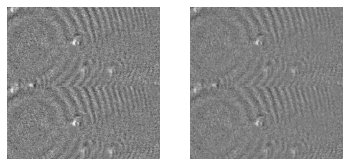

Step: 980	Loss: 0.009366113692522049


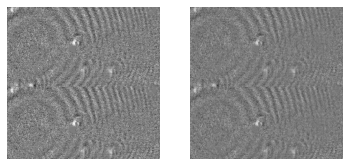

Step: 990	Loss: 0.009099908173084259


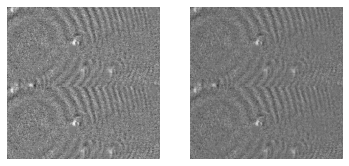

In [193]:
losses = []
for i in range(num_batches):
    optimizer.zero_grad()
    model.train()
    output = model(tensor_img)
    loss = criterion(tensor_img, output)
    loss.backward()
    losses += [loss.item()]
    optimizer.step()
    if i % 10 == 0:
        print(f"Step: {i}\tLoss: {losses[-1]}")
        plot_reconstruction(output, tensor_img)

In [225]:
import numpy as np
device = ("cuda" if torch.cuda.is_available() else "cpu")
tensor_img = torch.Tensor(np.array(img.crop((256,0,256+132,132))) / (2**16)).unsqueeze(0).unsqueeze(0)
tensor_img = tensor_img.to(device)
input_noise = torch.ones(1, 64, 316, 316).to(device) * 0.40784
model = unet.UNet(skip_connections=False, padding=0, c_channels=64)
model.to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

num_batches = 1000

In [224]:
torch.ones(1, 64, 316, 316).to(device) * 3

tensor([[[[3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          ...,
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.]],

         [[3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          ...,
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.]],

         [[3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          ...,
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.]],

         ...,

         [[3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          [3., 3., 3.,  ..., 3., 3., 3.],
          ...,
          [3., 3., 3.,  ..., 3., 3., 

Step: 0	Loss: 21381.220703125


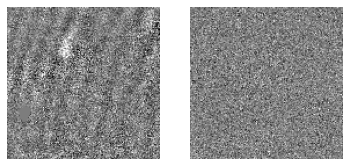

Step: 10	Loss: 0.36968255043029785


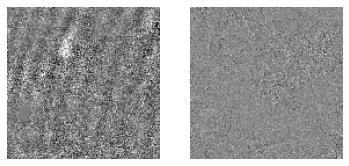

Step: 20	Loss: 0.25422847270965576


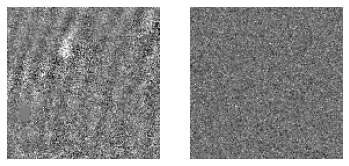

Step: 30	Loss: 0.22912518680095673


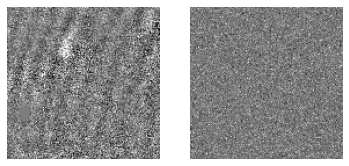

Step: 40	Loss: 0.20329353213310242


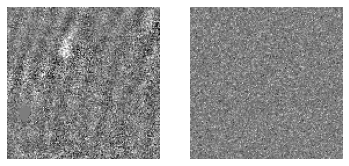

Step: 50	Loss: 0.17700977623462677


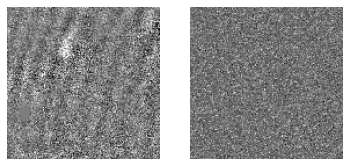

Step: 60	Loss: 0.15513134002685547


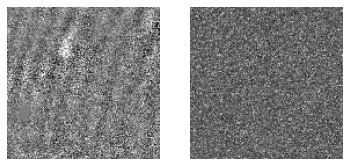

Step: 70	Loss: 0.13698776066303253


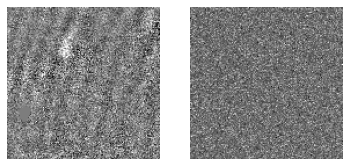

Step: 80	Loss: 0.12277670204639435


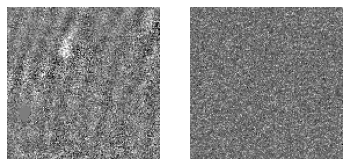

Step: 90	Loss: 0.11055432260036469


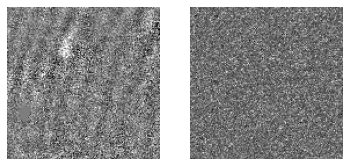

Step: 100	Loss: 0.10016991943120956


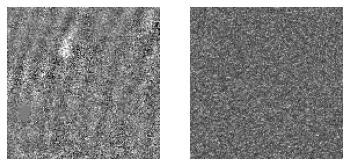

Step: 110	Loss: 0.09206734597682953


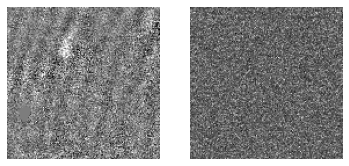

Step: 120	Loss: 0.08617164939641953


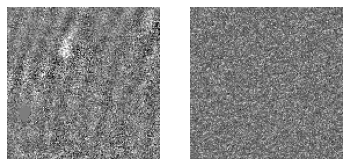

Step: 130	Loss: 0.08098937571048737


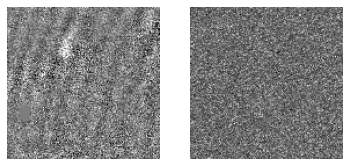

Step: 140	Loss: 0.07813745737075806


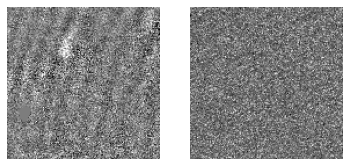

Step: 150	Loss: 0.07538889348506927


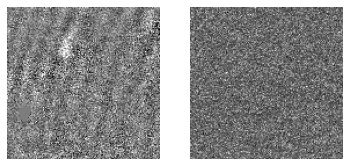

Step: 160	Loss: 0.07300307601690292


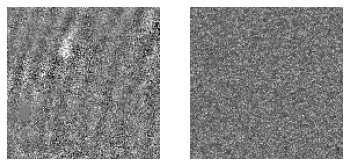

Step: 170	Loss: 0.07034042477607727


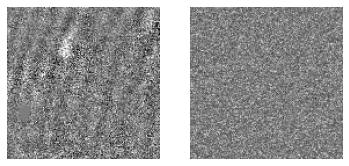

Step: 180	Loss: 0.06879452615976334


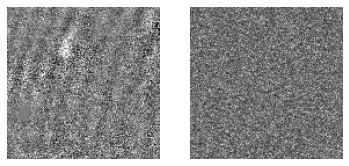

Step: 190	Loss: 0.06728911399841309


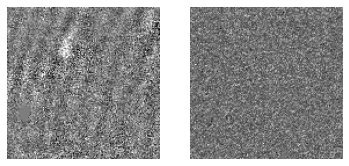

Step: 200	Loss: 0.06510764360427856


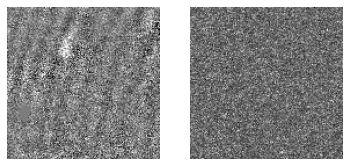

Step: 210	Loss: 0.06434429436922073


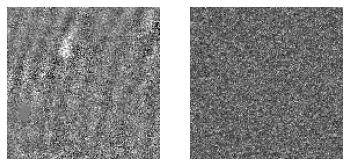

Step: 220	Loss: 0.061867132782936096


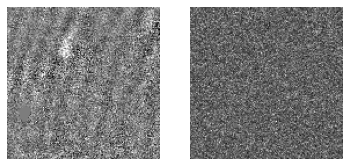

Step: 230	Loss: 0.06047366186976433


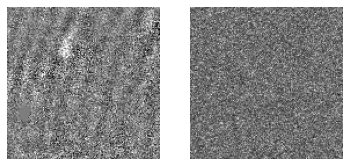

Step: 240	Loss: 0.059187863022089005


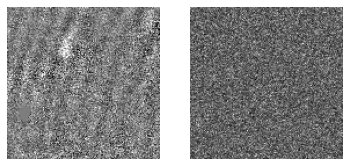

Step: 250	Loss: 0.058598652482032776


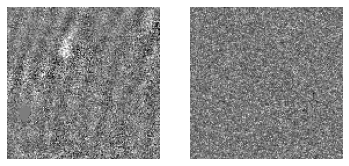

Step: 260	Loss: 0.05653860419988632


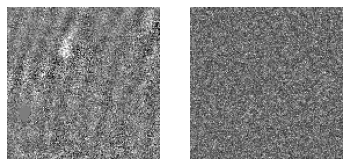

Step: 270	Loss: 0.055928874760866165


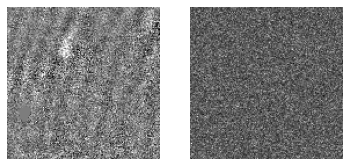

Step: 280	Loss: 0.053805358707904816


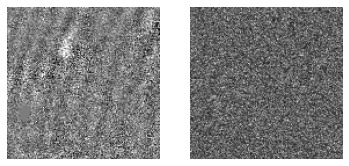

Step: 290	Loss: 0.05346627160906792


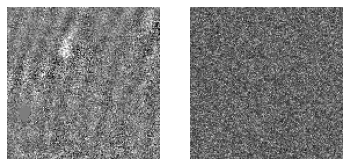

Step: 300	Loss: 0.051833249628543854


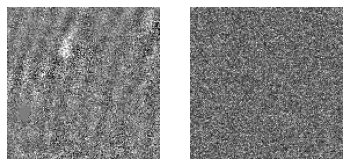

Step: 310	Loss: 0.05105672776699066


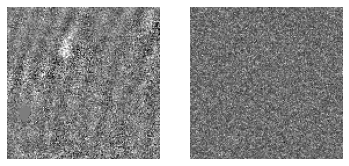

Step: 320	Loss: 0.05008085072040558


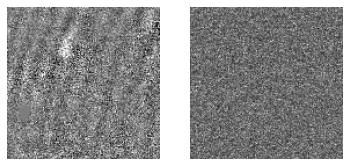

Step: 330	Loss: 0.04942624643445015


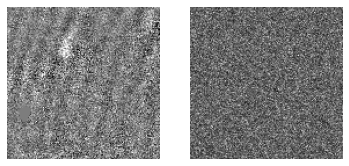

Step: 340	Loss: 0.048122990876436234


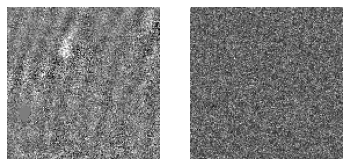

Step: 350	Loss: 0.048634570091962814


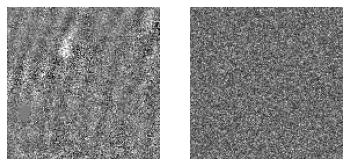

Step: 360	Loss: 0.046942513436079025


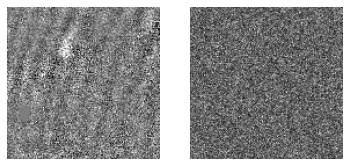

Step: 370	Loss: 0.04671579226851463


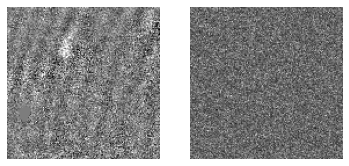

Step: 380	Loss: 0.04571572318673134


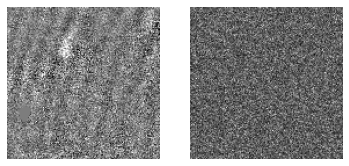

Step: 390	Loss: 0.04470381513237953


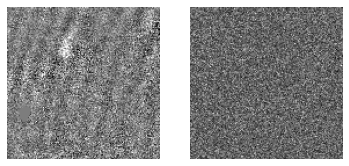

Step: 400	Loss: 0.04449402913451195


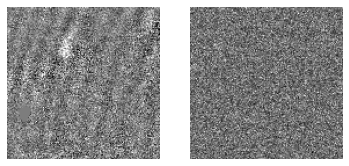

Step: 410	Loss: 0.04356388375163078


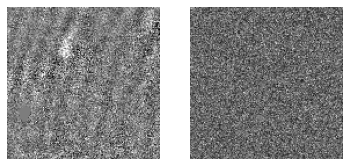

Step: 420	Loss: 0.0426824614405632


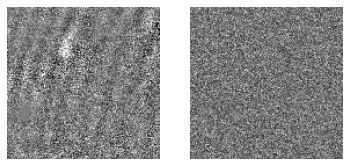

Step: 430	Loss: 0.04208685830235481


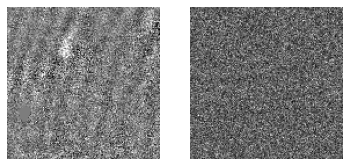

Step: 440	Loss: 0.042180392891168594


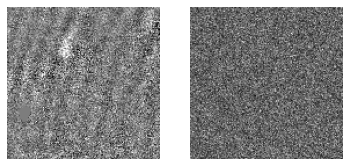

Step: 450	Loss: 0.041513070464134216


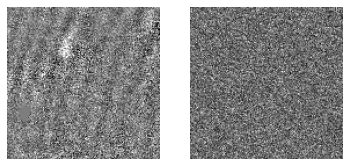

Step: 460	Loss: 0.04049156978726387


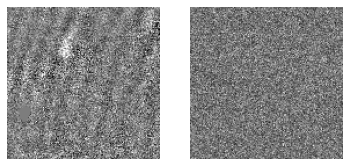

Step: 470	Loss: 0.04058602824807167


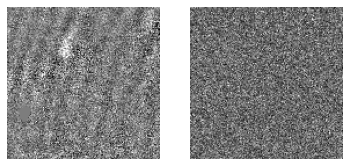

Step: 480	Loss: 0.03973459452390671


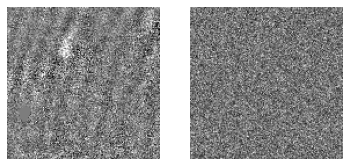

Step: 490	Loss: 0.039715468883514404


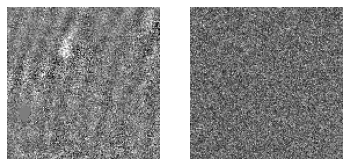

Step: 500	Loss: 0.0387675017118454


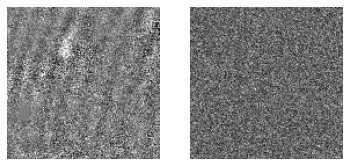

Step: 510	Loss: 0.03899576514959335


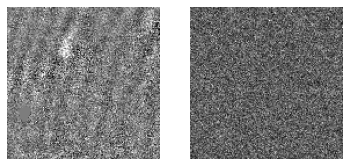

Step: 520	Loss: 0.03836967796087265


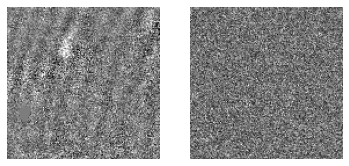

Step: 530	Loss: 0.03756992891430855


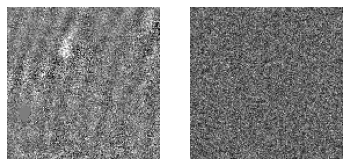

Step: 540	Loss: 0.03726441413164139


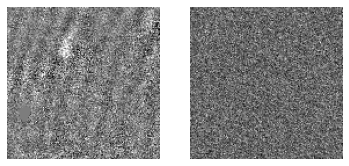

Step: 550	Loss: 0.037518132477998734


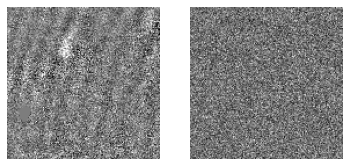

Step: 560	Loss: 0.03696282580494881


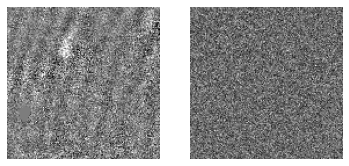

Step: 570	Loss: 0.03646722435951233


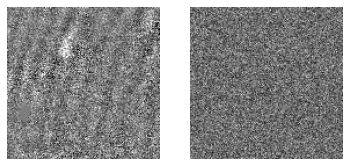

Step: 580	Loss: 0.03689219802618027


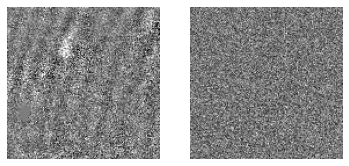

Step: 590	Loss: 0.035920072346925735


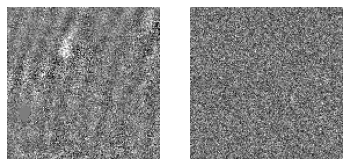

Step: 600	Loss: 0.03560689464211464


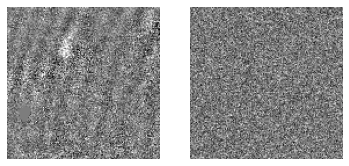

Step: 610	Loss: 0.035581886768341064


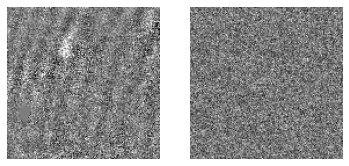

Step: 620	Loss: 0.03537113592028618


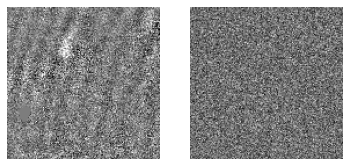

Step: 630	Loss: 0.035102710127830505


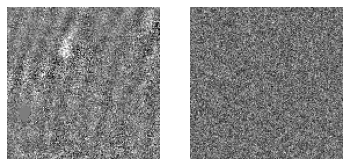

Step: 640	Loss: 0.034669116139411926


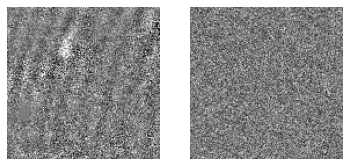

Step: 650	Loss: 0.034460242837667465


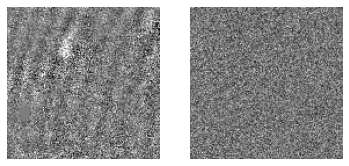

Step: 660	Loss: 0.03386438637971878


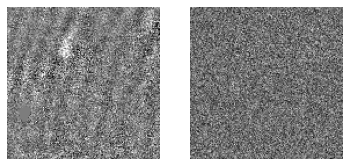

Step: 670	Loss: 0.03431980311870575


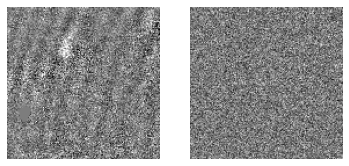

Step: 680	Loss: 0.03397481516003609


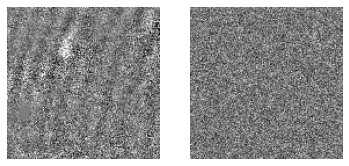

Step: 690	Loss: 0.03367835283279419


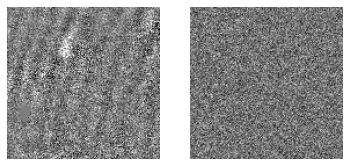

Step: 700	Loss: 0.03342166543006897


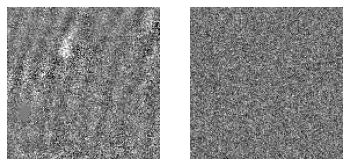

Step: 710	Loss: 0.033560823649168015


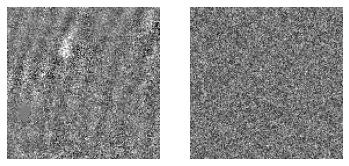

Step: 720	Loss: 0.03317704051733017


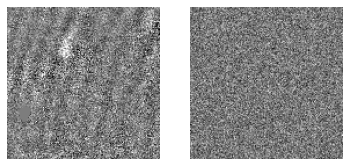

Step: 730	Loss: 0.033396583050489426


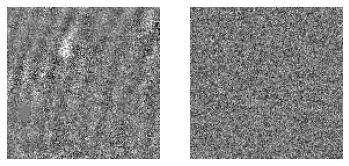

Step: 740	Loss: 0.033237699419260025


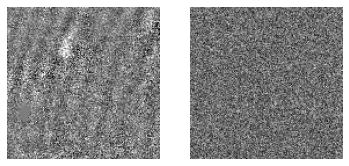

Step: 750	Loss: 0.033216848969459534


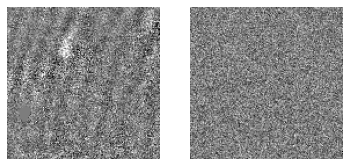

Step: 760	Loss: 0.03265849128365517


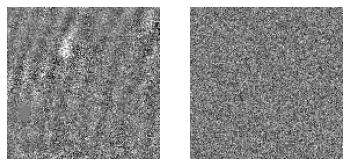

Step: 770	Loss: 0.032680537551641464


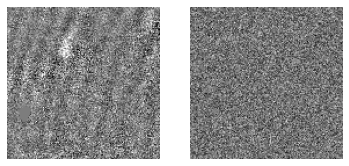

Step: 780	Loss: 0.03226737678050995


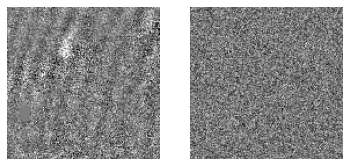

Step: 790	Loss: 0.032016124576330185


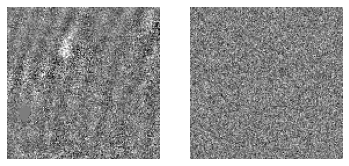

Step: 800	Loss: 0.031793490052223206


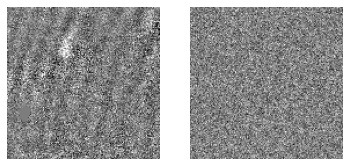

Step: 810	Loss: 0.03218894824385643


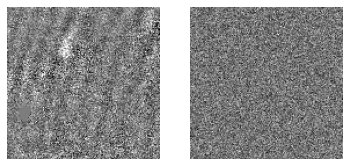

Step: 820	Loss: 0.032166771590709686


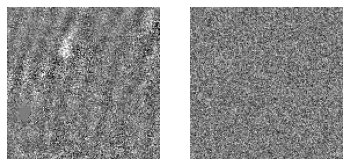

Step: 830	Loss: 0.03152704983949661


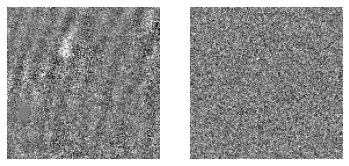

Step: 840	Loss: 0.0317789763212204


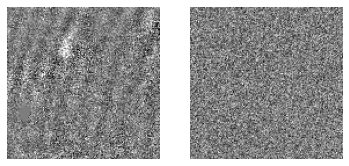

Step: 850	Loss: 0.03173051401972771


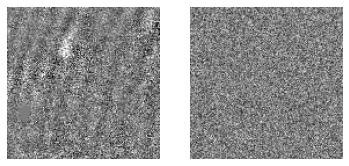

Step: 860	Loss: 0.031422246247529984


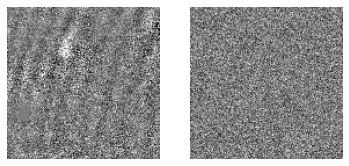

Step: 870	Loss: 0.0312652587890625


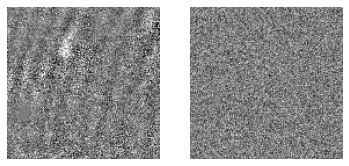

Step: 880	Loss: 0.0317687913775444


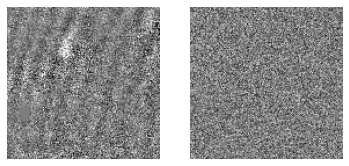

Step: 890	Loss: 0.030848132446408272


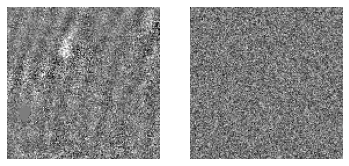

Step: 900	Loss: 0.031073717400431633


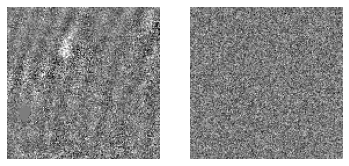

Step: 910	Loss: 0.03082803636789322


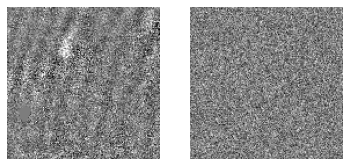

Step: 920	Loss: 0.030762244015932083


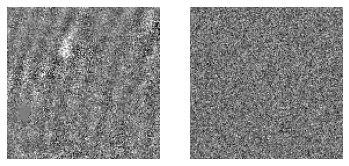

Step: 930	Loss: 0.030527211725711823


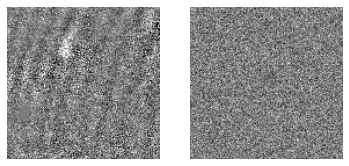

Step: 940	Loss: 0.030519146472215652


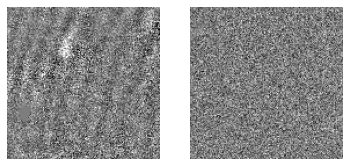

Step: 950	Loss: 0.030829794704914093


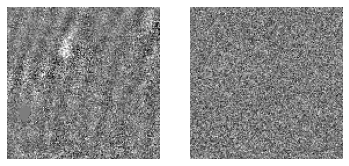

Step: 960	Loss: 0.030458344146609306


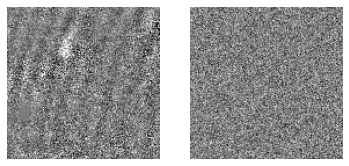

Step: 970	Loss: 0.030638428404927254


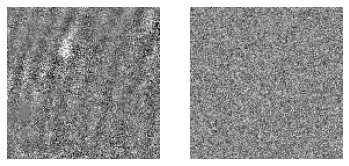

Step: 980	Loss: 0.03042418695986271


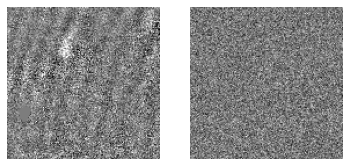

Step: 990	Loss: 0.030108975246548653


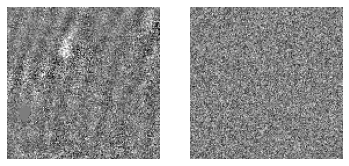

In [226]:
losses = []
for i in range(num_batches):
    optimizer.zero_grad()
    model.train()
    output = model(input_noise)
    #print(output.size())
    loss = criterion(tensor_img, output)
    loss.backward()
    losses += [loss.item()]
    optimizer.step()
    if i % 10 == 0:
        print(f"Step: {i}\tLoss: {losses[-1]}")
        plot_reconstruction(output, tensor_img)

In [ ]:
from torchvision import transforms, datasets
BATCH_SIZE = 1
transform = transforms.Compose([     
                                transforms.Grayscale(),    
                                transforms.Resize(572)   ,                    
                                transforms.RandomHorizontalFlip(p=.5),
                                transforms.RandomCrop(572),
                                transforms.ToTensor()
])
dataset = datasets.ImageFolder('./drive/My Drive/pamono', transform=transform)
train_data, val_data = torch.utils.data.random_split(dataset, [1500, 450])
img_datasets = {'train': train_data, 
            'val': val_data }
dataloaders = {x: torch.utils.data.DataLoader(img_datasets[x], batch_size=BATCH_SIZE, shuffle=True, num_workers=4) for x in ['train', 'val']}
dataset_sizes = {x: len(img_datasets[x]) for x in ['train', 'val']}
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

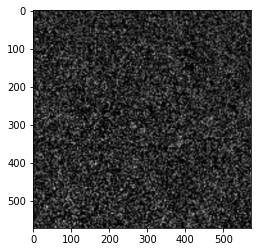

In [ ]:
batch, _ = next(iter(img_datasets['train']))
batch.size()

import matplotlib.pyplot as plt

plt.imshow(batch[0], cmap='gray')

In [ ]:
import time
import copy
import math
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
  print(f"Train on {dataset_sizes['train']}, validate on {dataset_sizes['val']} images")
  since = time.time()

  running_loss = []
  running_batch_sizes = []
  val_loss = []
  eval_window = 150

  for epoch in range(num_epochs):
      
    model.train()
    for inputs, _ in dataloaders['train']:
      inputs = inputs.to(device)

      optimizer.zero_grad()

      outputs = model(inputs)
      loss = criterion(outputs, inputs)

      loss.backward()
      optimizer.step()

      running_loss.append(loss.item() * inputs.size(0))
      running_batch_sizes.append(inputs.size(0))

      scheduler.step()
    
    print('Epoch: {}\tLoss: {:.4f}'.format(epoch, np.sum(running_loss[-math.ceil(dataset_sizes['train'] / BATCH_SIZE):]) / dataset_sizes['train']))
    
    model.eval()
    total_loss = 0.0
    total_corrects = 0
    for inputs, _ in dataloaders['val']:
      inputs = inputs.to(device)

      with torch.no_grad():
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, inputs)

      total_loss += loss.item() * inputs.size(0)

    val_loss.append(total_loss / dataset_sizes['val'])
    print('Eval:\tLoss: {:.4f}'.format(val_loss[-1]))

  time_elapsed = time.time() - since
  print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))

  return model, running_loss, running_batch_sizes, val_loss

In [ ]:
import torch.optim as optim
from torch.optim import lr_scheduler

model = UNet()
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.1, momentum=0.9, weight_decay=0.0001)

exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=32000, gamma=0.1)
NUM_EPOCHS = 1
trained_model, loss, bs, val_loss  = train_model(model, criterion, optimizer, exp_lr_scheduler, num_epochs=NUM_EPOCHS)

Train on 1500, validate on 450 images


RuntimeError: ignored